In [91]:
import gensim
import pandas
import matplotlib.pylab as plt
import numpy as np
import mpld3

%matplotlib inline

In [85]:
today = '2017-08-28'
df = pandas.read_csv('data/tickets_df_%s.tsv' %today, sep='\t', index_col=0)
df = df[df.message.isnull()==False]

In [92]:
df.head()
df.shape

(16726, 6)

In [96]:
from bs4 import BeautifulSoup

def row_to_words(row):
    cleaned = BeautifulSoup(row.message,"lxml").text
    words = cleaned.split()
    return [x for x in words if x.isalpha()]

In [119]:
sentences = []
topics = dict()
for index, row in df.iterrows():
    sentence = row_to_words(row)
    if len(sentence) > 5:
        if row.System not in topics:
            topics[row.System] = [sentence]
        else:
            topics[row.System].append(sentence)
        sentences.append(sentence)

In [99]:
from __future__ import print_function

from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.decomposition import NMF, LatentDirichletAllocation
from sklearn.datasets import fetch_20newsgroups
import matplotlib

n_samples = len(sentences)
n_features = 1000
n_components = 10
n_top_words = 20

# Colormap
my_cmap = matplotlib.cm.get_cmap('rainbow')                              
my_cmap.set_under('w')

def print_top_words(model, feature_names, n_top_words):
    for topic_idx, topic in enumerate(model.components_):
        message = "Topic #%d: " % topic_idx
        message += " ".join([feature_names[i]
                             for i in topic.argsort()[:-n_top_words - 1:-1]])
        print(message)
    print()


In [100]:
len(sentences)

14090

## TF-IDA with KMeans for Entire Dataset

In [103]:
from sklearn.decomposition.pca import PCA
tfidf_vectorizer = TfidfVectorizer(max_df=0.95, min_df=2,
                                   max_features=n_features,
                                   stop_words='english')

# TF-IDF Vectorization Matrix 
data = [' '.join(x) for x in sentences]
vect = TfidfVectorizer(stop_words='english', max_df=0.50, min_df=2)
X = vect.fit_transform(data)

X_dense = X.todense()
coords = PCA(n_components=2).fit_transform(X_dense)

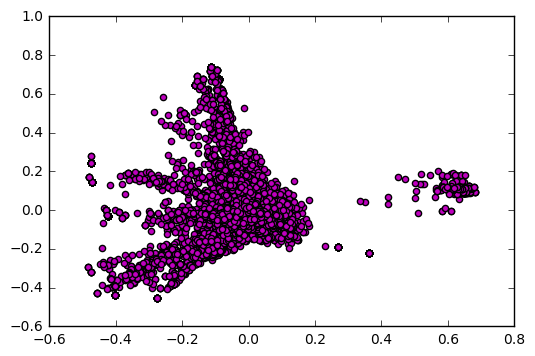

In [104]:
plt.scatter(coords[:, 0], coords[:, 1], c='m')
plt.show()

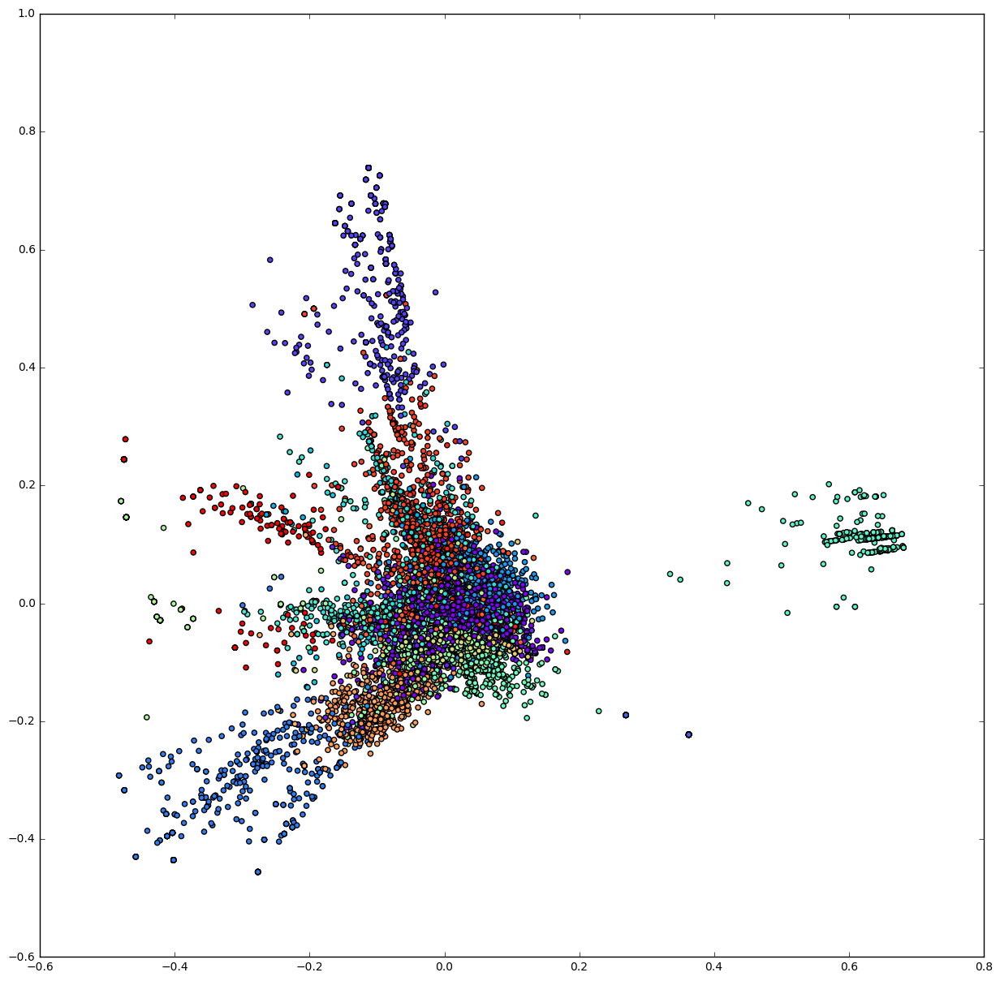

In [111]:
from sklearn.cluster import KMeans

n_clusters = 25
clf = KMeans(n_clusters=n_clusters, max_iter=100, init='k-means++', n_init=1)
labels = clf.fit_predict(X)
#scatter = plt.scatter(coords[:, 0], coords[:, 1], c=labels,cmap=my_cmap)
#plt.show()

# Make interactive
fig, ax = plt.subplots(figsize=(15,15))
scatter = ax.scatter(coords[:, 0], coords[:, 1], c=labels,cmap=my_cmap)
tooltip = mpld3.plugins.PointLabelTooltip(scatter, labels=data)
plt.show()

ax.set_title("Ticket Groupings", size=20)
mpld3.plugins.connect(fig, tooltip)
mpld3.display(fig)

In [113]:
mpld3.save_html(fig,'docs/index.html')

## TF-IDA with KMeans for Each System

In [123]:
from sklearn.decomposition.pca import PCA
tfidf_vectorizer = TfidfVectorizer(max_df=0.95, min_df=2,
                                   max_features=n_features,
                                   stop_words='english')

print("Systems are %s" %topics.keys())
# TF-IDF Vectorization Matrix 
for system,lines in topics.items():
    if len(lines) <= 10:
        continue
    data = [' '.join(x) for x in lines]
    vect = TfidfVectorizer(stop_words='english', max_df=0.50, min_df=2)
    X = vect.fit_transform(data)
    X_dense = X.todense()
    coords = PCA(n_components=2).fit_transform(X_dense)
    n_clusters = 10
    clf = KMeans(n_clusters=n_clusters, max_iter=100, init='k-means++', n_init=1)
    labels = clf.fit_predict(X)
    # Make interactive
    fig, ax = plt.subplots(figsize=(15,15))
    scatter = ax.scatter(coords[:, 0], coords[:, 1], c=labels,cmap=my_cmap)
    tooltip = mpld3.plugins.PointLabelTooltip(scatter, labels=data)
    ax.set_title("%s Ticket Groupings" %system, size=20)
    mpld3.plugins.connect(fig, tooltip)
    mpld3.display(fig)
    mpld3.save_html(fig,'docs/%s.html' %system)

Systems are dict_keys([nan, 'SCG', 'Lab- Quake', 'Lab- Chichilnisky', 'XStream', 'PHS', 'SNI', 'Farmshare', 'Sherlock', 'Oak', 'Lab- Etkin', 'BioX3', 'GSB', 'Lab- HIDPL', 'Kratos', 'Other'])


In [18]:
model = gensim.models.Word2Vec(sentences, size=200, min_count=10)

In [23]:
vocab = model.vocab.keys()
print(vocab)

['limited', 'Andreas', 'Rocks', 'fairshare', 'Licensing', 'During', 'biopython', 'option', 'dynamic', 'all', 'reboot', 'four', 'catch', 'prefix', 'Does', 'hanging', 'saved', 'Until', 'job', 'forget', 'looking', 'patches', 'eligible', 'umask', 'weiqi', 'containing', 'supported', 'Host', 'openmpi', 'certain', 'matlab', 'Unknown', 'Shirley', 'sorry', 'wall', 'worth', 'barley', 'updated', 'risk', 'activation', 'connects', 'ACLs', 'every', 'updates', 'upstream', 'Morten', 'vasp', 'keeptoken', 'bringing', 'encounter', 'look', 'tickets', 'Thomas', 'Data', 'Internet', 'supports', 'ANNUAL', 'upload', 'HIVE', 'SNI', 'Process', 'MAC', 'unrelated', 'notifying', 'math', 'affect', 'launches', 'indices', 'provided', 'Paul', 'readme', 'Sandy', 'Nandita', 'csh', 'sentaurus', 'Truven', 'lustre', 'consistent', 'guidelines', 'Makefile', 'direct', 'batch', 'Matthew', 'second', 'Version', 'follow', 'implemented', 'Expires', 'machines', 'Webinars', 'even', 'established', 'Generating', 'errors', 'LSB', 'minim

In [24]:
len(vocab)

4973

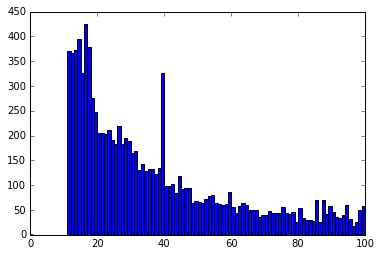

In [25]:
plt.hist([len(sen) for sen in sentences], bins=100, range=(0,100));

## Now for some fun!

In [27]:
people = ['Karl','Vanessa', 'Ruth', 'Kilian', 'Phil', 'Alex', 'Brian', 'Sherlock','Farmshare','SCG','Stefan', 'error', 'cores', 'cpu', 'gpu', 'computer']
for person in people:
    assert person in vocab

In [28]:
sim_mat = np.matrix([[model.similarity(a,b) for a in people] for b in people])
num_people = len(people)

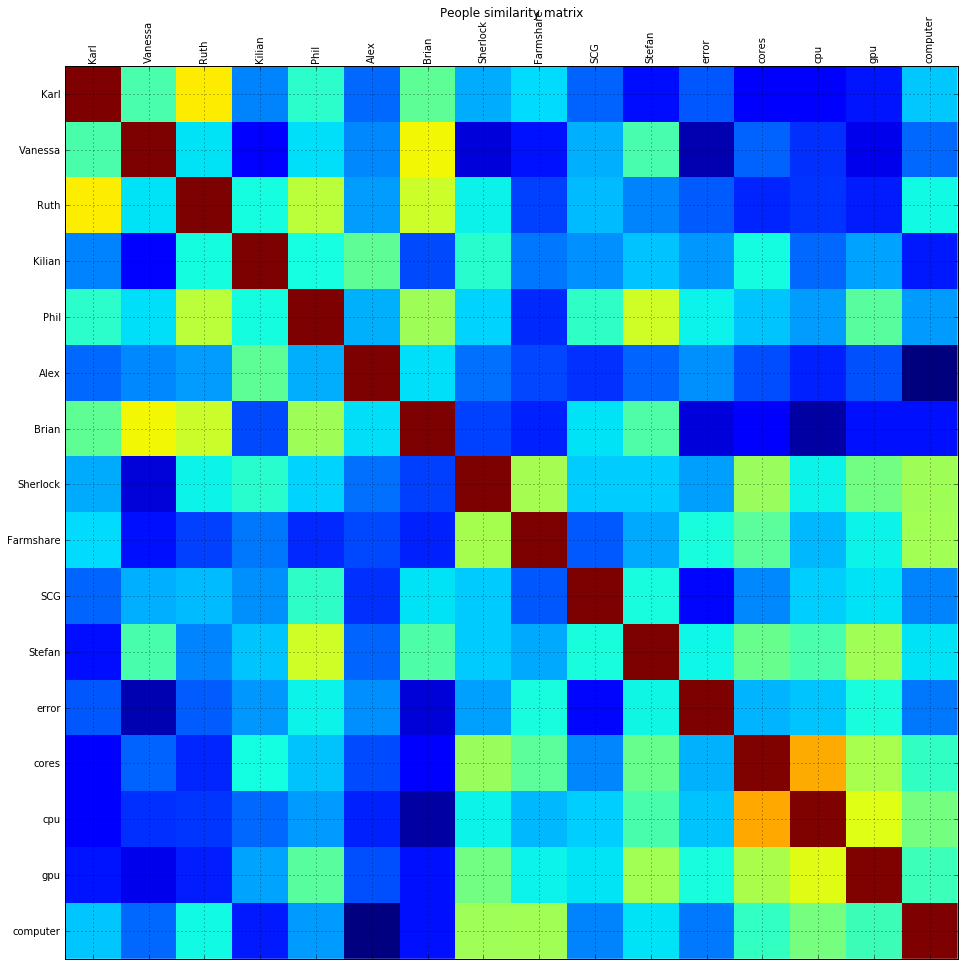

In [29]:
fig, ax = plt.subplots(figsize=(num_people, num_people))
cax = ax.matshow(sim_mat, interpolation='none')
ax.grid(True)
plt.title('People similarity matrix')
plt.xticks(range(num_people), people, rotation=90);
plt.yticks(range(num_people), people);
plt.show()

## Plot Individual words using dimensionality reduction

In [30]:
from sklearn.manifold import LocallyLinearEmbedding
from sklearn.decomposition import PCA

In [31]:
### Limited vocab size to make it run faster.
# vocab_1000 = vocab[:1000]

In [42]:
%%time
## should take about 13 minutes for 7000 words, scales quadratically.
sim_mat = np.matrix([[model.similarity(a,b) for a in vocab] 
                     for b in vocab])

CPU times: user 3min 7s, sys: 372 ms, total: 3min 7s
Wall time: 3min 7s


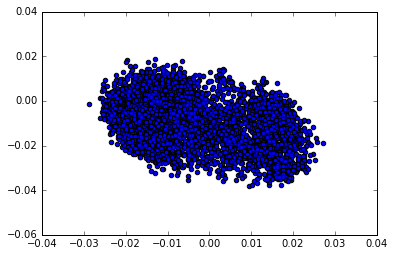

In [43]:
pca = PCA(n_components=2)
pca.fit(sim_mat)
plt.scatter(*pca.components_)

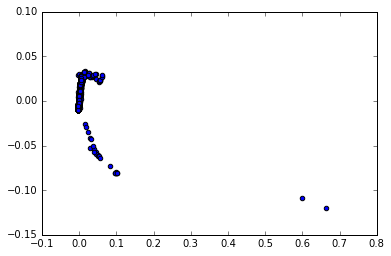

In [44]:
lle = LocallyLinearEmbedding(method='modified')
lle.fit(sim_mat,)
plt.scatter(*lle.embedding_.T)

## Similarities between messages using min and max

In [35]:
def sentence_emb(sen):
    """Find the coordiante-wise min and max of the word embeddings in a sentence
    """
    arr = np.array([model[word] for word in sen if word in model])
    return np.concatenate([arr.min(axis=0), arr.max(axis=0)])

In [36]:
## Get sentence embeddings
sentence_embeddings = [sentence_emb(sen) for sen in sentences]
sentence_embeddings = [emb for emb in sentence_embeddings if emb is not None]

In [37]:
len(sentence_embeddings)

12210

In [38]:
## Used for interactive scatterplot
labels = ['-'.join(sen) for sen in sentences]

In [39]:
%%time
## Find sentence embeddings similarities
sim_mat = np.matrix([[np.dot(a,b) for a in sentence_embeddings] 
                     for b in sentence_embeddings])

CPU times: user 2min 8s, sys: 2.66 s, total: 2min 10s
Wall time: 2min 10s


In [40]:
## PCA analysis. Only used PCA since it's fast (but still took a while...)
pca = PCA(n_components=2)
pca.fit(sim_mat)

PCA(copy=True, iterated_power='auto', n_components=2, random_state=None,
  svd_solver='auto', tol=0.0, whiten=False)

In [260]:
# plt.figure(figsize=(20,20))
# plt.scatter(*pca.components_)
# plt.show()

## Interactive scatterplot

In [41]:
fig, ax = plt.subplots(figsize=(15,15))
scatter = ax.scatter(*pca.components_)
ax.set_title("Sentence embeddings", size=20)
tooltip = mpld3.plugins.PointLabelTooltip(scatter, labels=labels)
mpld3.plugins.connect(fig, tooltip)
mpld3.display(fig)